# Model Training

In this notebook, a PyTorch Faster R-CNN with MobileNetv3-Backbone is trained. The backbone was pretrained on the COCO-Dataset.
https://pytorch.org/tutorials/intermediate/torchvision_tutorial.html

At the end of the script, the model is tested by predicting and visualizing predictions for test images.

## Pip installs

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip uninstall albumentations
!pip install -qU torch_snippets

Found existing installation: albumentations 0.1.12
Uninstalling albumentations-0.1.12:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/albumentations-0.1.12.dist-info/*
    /usr/local/lib/python3.7/dist-packages/albumentations/*
Proceed (y/n)? y
  Successfully uninstalled albumentations-0.1.12
     |████████████████████████████████| 49 kB 3.5 MB/s 
     |████████████████████████████████| 948 kB 14.3 MB/s 
     |████████████████████████████████| 58 kB 6.1 MB/s 
     |████████████████████████████████| 235 kB 56.4 MB/s 
     |████████████████████████████████| 78 kB 5.6 MB/s 
     |████████████████████████████████| 51 kB 7.2 MB/s 


# Global Parameters

In [ ]:
width, height = 1000, 1000
IMAGE_ROOT = '/content/drive/MyDrive/data/euro-coin-dataset-master'
batch_size = 4
n_epochs = 300

# Imports

In [ ]:
import copy
import glob
import torch
import time
import statistics
import pandas as pd
import cv2

from os.path import join
from torch_snippets import *
from PIL import Image

# Set parameters

In [ ]:
%cd /content/drive/MyDrive/data

In [ ]:
rootdir = '/content/drive/MyDrive/data'
output_imgs = '/content/drive/MyDrive/outputs/imgs'
output_models = '/content/drive/MyDrive/outputs/models'
output_model_checkpoints = '/content/drive/MyDrive/outputs/models/checkpoints'
output_reports = '/content/drive/MyDrive/outputs/reports'
output_training_report = 'faster_rcnn_mobilenetv3_large.csv'
output_model_name = 'faster_rcnn_mobilenetv3_large.pt'

## Load Dataframes (train & test)

In [ ]:
df_train = pd.read_csv(os.path.join(rootdir, 'train.csv'))
df_test = pd.read_csv(os.path.join(rootdir, 'test.csv'))
df_train.head(10)

,folder,filename,width,height,depth,segmented,name,pose,truncated,difficult,xmin,ymin,xmax,ymax
0,50,20210324_193102.jpg,3024,3024,3,0,50,50,50,50,999,1084,1434,1496
1,50,20210324_193102.jpg,3024,3024,3,0,50,50,50,50,1540,1071,2003,1502
2,50,20210324_193102.jpg,3024,3024,3,0,50,50,50,50,687,1515,1168,1968
3,50,20210324_193102.jpg,3024,3024,3,0,50,50,50,50,1309,1552,1768,1993
4,50,20210324_193102.jpg,3024,3024,3,0,50,50,50,50,1899,1549,2381,2006
5,50,20210324_192956.jpg,3024,3024,3,0,50,50,50,50,1093,940,1440,1268
6,50,20210324_192956.jpg,3024,3024,3,0,50,50,50,50,1499,931,1862,1274
7,50,20210324_192956.jpg,3024,3024,3,0,50,50,50,50,906,1296,1234,1599
8,50,20210324_192956.jpg,3024,3024,3,0,50,50,50,50,1346,1296,1706,1637
9,50,20210324_192956.jpg,3024,3024,3,0,50,50,50,50,1768,1293,2112,1609


#### Encode target class

static definition of label2target and target2label to avoid regular changes in the backend

In [ ]:
target2label = {1: 1, 2: 10, 3: 100, 4: 2, 5: 20, 6: 200, 7: 5, 8: 50, 0: 'background'} #{t:l for l,t in label2target.items()}
# label2target = {l:t+1 for t,l in enumerate(df_train['pose'].unique())}
label2target = {v: k for k, v in target2label.items()}
label2target['background'] = 0
background_class = label2target['background']
num_classes = len(label2target)

print(target2label)

{1: 1, 2: 10, 3: 100, 4: 2, 5: 20, 6: 200, 7: 5, 8: 50, 0: 'background'}


In [ ]:
label2target

{1: 1, 10: 2, 100: 3, 2: 4, 20: 5, 200: 6, 5: 7, 50: 8, 'background': 0}

In [ ]:
target2label

{0: 'background', 1: 1, 2: 10, 3: 100, 4: 2, 5: 20, 6: 200, 7: 5, 8: 50}

In [ ]:
# {1: 1, 2: 10, 3: 100, 4: 2, 5: 20, 6: 200, 7: 5, 8: 50, 0: 'background'}

# Preprocess and transform Data

In [ ]:
# Put channels to front: instead of width x height x channels we transform order
# to channels x width x height
def preprocess_image(img):
  img = torch.tensor(img).permute(2,0,1)
  return img.to(device).float()

In [ ]:
# Preprocess data

def preprocess_traindata(img, data, target_width, target_height):
  current_width, current_height = img.size
  
  # scale absolute bounding box positions to percentage value
  data[:,[0,2]] = (data[:,[0,2]] / current_width * target_width).astype(int)
  data[:,[1,3]] = (data[:,[1,3]] / current_height * target_height).astype(int)

  # img = img.transpose(Image.ROTATE_270)
  # scale coloring to 0-1 range 
  img = np.array(img.resize((width, height), resample=Image.BILINEAR))/255.

  return img, data

In [ ]:
import torchvision.transforms.functional as F
import random

transform_log = []

# Image augmentation is required due to lack of training data
def random_transform(img, boxes, labels, threshold = 0.2):
  # if randomly generated value greater than threshold transformation will be
  # performed

  tmp = []
  # Adjust contrast
  rand = random.random()
  if rand < threshold:
    img = F.adjust_contrast(img,2)
    tmp.append('contrast')

  #Adjust brightness
  rand = random.random()
  if rand < threshold:
    img = F.adjust_brightness(img, 2)
    tmp.append('brightness')

  #Adjust saturation
  rand = random.random()
  if rand < threshold:
    img = F.adjust_saturation(img, 2)
    tmp.append('saturation')

  # Adjust blur
  rand = random.random()
  if rand < threshold:
    img = F.gaussian_blur(img, kernel_size=(5, 9))
    tmp.append('blur')

  #To Grayscale
  rand = random.random()
  if rand < threshold:
    img = F.to_grayscale(img, num_output_channels=3)
    tmp.append('grayscale')

  # Horizontal flip
  rand = random.random()
  if rand < threshold:
    new_image = F.hflip(img)
    #flip boxes
    new_x_max = img.width - boxes[:, 0]
    new_x_min = img.width - boxes[:, 2]
    if not (new_x_min.max() > img.width or new_x_max.max() > img.width):
      boxes[:, 0] = new_x_min
      boxes[:, 2] = new_x_max
      img = new_image
      tmp.append('hflip')

  # Vertical flip
  rand = random.random()
  if rand < threshold:
    new_image = F.vflip(img)
    #flip boxes
    new_y_max = img.height - boxes[:, 1]
    new_y_min = img.height - boxes[:, 3]
  
    if not (new_y_min.max() > img.height or new_y_max.max() > img.height):
      boxes[:, 1] = new_y_min
      boxes[:, 3] = new_y_max
      img = new_image
      tmp.append('vflip')
  transform_log.append(tmp)
  return img, boxes, labels

# Dataset

In [ ]:
# Dataset class that will be used for training
class CoinDataset(torch.utils.data.Dataset):
  w, h = width, height
  def __init__(self, df, image_dir=IMAGE_ROOT, transformer = None, threshold = 0.15):
    self.image_dir = image_dir
    self.files = glob.glob(IMAGE_ROOT + '/*/*')
    self.df = df
    self.image_infos = df['filename'].unique()
    self.transformer = transformer
    self.threshold = threshold

  def __getitem__(self, ix):

    #filename	pose	xmin	xmax	ymin	ymax

    # load image
    image_id = self.image_infos[ix]
    # dataset contains faults hence accessing data with folder won't work
    # # img_folder = self.df[self.df['filename'] == image_id]['folder'].unique()[0]
    # # img_path = os.path.join(self.image_dir, img_folder, image_id)
    # instead use this:
    img_path = find(image_id, self.files)



    img = Image.open(img_path).convert('RGB')

    data = self.df[self.df['filename'] == image_id]
    labels = data['pose'].values.tolist()
    data = data[['xmin','ymin','xmax','ymax']].values

    if self.transformer:
      img, data, labels = self.transformer(img, data, labels, self.threshold)

    img, data = preprocess_traindata(img, data, self.w, self.h)

    boxes = data.astype(np.uint32).tolist() # convert to absolute coordinates
    # torch FRCNN expects ground truths as a dictionary of tensors
    target = {}
    target['boxes'] = torch.Tensor(boxes).float()
    target['labels'] = torch.Tensor([label2target[i] for i in labels]).long()
    img = preprocess_image(img)


    return img, target

  def collate_fn(self, batch):
    return tuple(zip(*batch)) 

  def __len__(self):
    return len(self.image_infos)

## Create dataset

In [ ]:
train_ds = CoinDataset(df_train, transformer = random_transform)
test_ds = CoinDataset(df_test)

## Create dataloader

In [ ]:
train_loader = DataLoader(train_ds, batch_size=batch_size, collate_fn=train_ds.collate_fn, drop_last=True)
test_loader = DataLoader(test_ds, batch_size=batch_size, collate_fn=test_ds.collate_fn, drop_last=True)

# Train Model

#### Load model and set up device for GPU-Training

In [ ]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator

device = 'cuda' if torch.cuda.is_available() else 'cpu'

def get_model():
  model = torchvision.models.detection.fasterrcnn_mobilenet_v3_large_fpn(pretrained=True)
  in_features = model.roi_heads.box_predictor.cls_score.in_features
  model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
  return model

#### Specify training process

In [ ]:
# Defining training and validation for a single batch
def train_batch(inputs, model, optimizer):
  model.train()
  input, targets = inputs
  input = list(image.to(device) for image in input)
  targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
  optimizer.zero_grad()
  losses = model(input, targets)
  loss = sum(loss for loss in losses.values())
  loss.backward()
  optimizer.step()
  return loss, losses

@torch.no_grad() # disable gradient computation
def validate_batch(inputs, model):
  model.train() # to obtain the losses, model needs to be in train mode only
  input, targets = inputs
  input = list(image.to(device) for image in input)
  targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

  optimizer.zero_grad()
  losses = model(input, targets)
  loss = sum(loss for loss in losses.values())
  return loss, losses

In [ ]:
model = get_model().to(device)
optimizer = torch.optim.SGD(model.parameters(), lr=0.0005,
                            momentum=0.9, weight_decay=0.0005)
log = Report(n_epochs)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=FasterRCNN_MobileNet_V3_Large_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_MobileNet_V3_Large_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth


  0%|          | 0.00/74.2M [00:00<?, ?B/s]

In [ ]:
# write after each iteration train/val loss to file to avoid information loss
# in case google session shuts down
def write_summary_to_file(summary):
  with open(join(output_reports, 'summary_mobilenet.csv'), 'a+') as fd:
    fd.write(summary + '\n')

In [ ]:
# Training iterations
for epoch in range(n_epochs):
  _n = len(train_loader)
  for ix, inputs in enumerate(train_loader):
    start = time.time()
    loss, losses = train_batch(inputs, model, optimizer)
    end = time.time()
    
    loc_loss, regr_loss, loss_objectness, loss_rpn_box_reg = \
        [losses[k] for k in ['loss_classifier','loss_box_reg','loss_objectness','loss_rpn_box_reg']]
    pos = (epoch + (ix+1)/_n)
    log.record(pos, trn_loss=loss.item(), trn_loc_loss=loc_loss.item(), 
                trn_regr_loss=regr_loss.item(), trn_objectness_loss=loss_objectness.item(),
                trn_rpn_box_reg_loss=loss_rpn_box_reg.item(), end='\r')
    
    # save to file
    write_summary_to_file(
        (
          f'{pos},TRAIN,{loss.item()},{loc_loss.item()},' 
          f'{regr_loss.item()},{loss_objectness.item()},'
          f'{loss_rpn_box_reg.item()}'
        )
    )


  _n = len(test_loader)
  for ix,inputs in enumerate(test_loader):
    loss, losses = validate_batch(inputs, model)
    loc_loss, regr_loss, loss_objectness, loss_rpn_box_reg = \
      [losses[k] for k in ['loss_classifier','loss_box_reg','loss_objectness','loss_rpn_box_reg']]
    pos = (epoch + (ix+1)/_n)
    log.record(pos, val_loss=loss.item(), val_loc_loss=loc_loss.item(), 
              val_regr_loss=regr_loss.item(), val_objectness_loss=loss_objectness.item(),
              val_rpn_box_reg_loss=loss_rpn_box_reg.item(), end='\r')
    
    # save to file 
    write_summary_to_file(
      (
        f'{pos},VAL,{loss.item()},{loc_loss.item()},' 
        f'{regr_loss.item()},{loss_objectness.item()},'
        f'{loss_rpn_box_reg.item()}'
      )
    )

  
  if epoch%4 == 0:
    torch.save(model.state_dict(), join(output_model_checkpoints, f'epoch_{epoch}_{output_model_name}'))

  log.report_avgs(epoch+1)

EPOCH: 1.000	trn_loss: 2.506	trn_loc_loss: 1.524	trn_regr_loss: 0.969	trn_objectness_loss: 0.008	trn_rpn_box_reg_loss: 0.005	val_loss: 2.017	val_loc_loss: 1.367	val_regr_loss: 0.639	val_objectness_loss: 0.005	val_rpn_box_reg_loss: 0.006	(1076.27s - 321805.26s remaining)
EPOCH: 2.000	trn_loss: 1.931	trn_loc_loss: 1.521	trn_regr_loss: 0.402	trn_objectness_loss: 0.004	trn_rpn_box_reg_loss: 0.004	val_loss: 1.911	val_loc_loss: 1.451	val_regr_loss: 0.453	val_objectness_loss: 0.003	val_rpn_box_reg_loss: 0.004	(1314.64s - 195880.88s remaining)
EPOCH: 3.000	trn_loss: 1.643	trn_loc_loss: 1.328	trn_regr_loss: 0.307	trn_objectness_loss: 0.005	trn_rpn_box_reg_loss: 0.003	val_loss: 1.819	val_loc_loss: 1.416	val_regr_loss: 0.396	val_objectness_loss: 0.004	val_rpn_box_reg_loss: 0.003	(1552.44s - 153692.02s remaining)
EPOCH: 4.000	trn_loss: 1.553	trn_loc_loss: 1.282	trn_regr_loss: 0.265	trn_objectness_loss: 0.004	trn_rpn_box_reg_loss: 0.003	val_loss: 1.886	val_loc_loss: 1.550	val_regr_loss: 0.329	val_o

#### How to avoid colab disconnections?

function ClickConnect(){
console.log("Working"); 
document.querySelector("colab-toolbar-button#toolbar-add-code").click() 
}setInterval(ClickConnect,120000)

#### Summarize Training

In [ ]:
df_training_result = pd.DataFrame.from_dict(epochs_summary)
df_training_result.to_csv(join(output_reports, output_training_report), index=False)
df_training_result.head(5)
# dump transform list

,epoch,time,loss,loss_classifier,loss_box_reg,loss_objectness,loss_rpn_box_reg
0,0,0.696855,3.382079,2.384439,0.967071,0.008780,0.021788
1,0,0.064048,3.276125,2.263020,0.980101,0.028695,0.004310
2,0,0.066062,3.696687,1.988468,1.677607,0.025464,0.005149
3,0,0.061604,3.193183,1.824970,1.349478,0.015991,0.002745
4,0,0.065766,3.050171,1.711976,1.321789,0.013293,0.003113


#### Save trained model

In [ ]:
torch.save(model.state_dict(), join(output_models, output_model_name))

# Test Model

In [ ]:
model = get_model()
model.load_state_dict(
        torch.load(
            join(output_models, 'checkpoints', 'epoch_280_faster_rcnn_mobilenetv3_large.pt'),
            map_location=device
        )
    )
model.to(device)

Downloading: "https://download.pytorch.org/models/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth


  0%|          | 0.00/74.2M [00:00<?, ?B/s]

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (0): ConvNormActivation(
        (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): FrozenBatchNorm2d(16, eps=1e-05)
        (2): Hardswish()
      )
      (1): InvertedResidual(
        (block): Sequential(
          (0): ConvNormActivation(
            (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
            (2): ReLU(inplace=True)
          )
          (1): ConvNormActivation(
            (0): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
          )
        )
      )
      (2): InvertedResidual(
        (block): Seque

In [ ]:
from torchvision.ops import nms
def decode_output(output):
  'convert tensors to numpy arrays'
  bbs = output['boxes'].cpu().detach().numpy().astype(np.uint16)
  labels = np.array([target2label[i] for i in output['labels'].cpu().detach().numpy()])
  confs = output['scores'].cpu().detach().numpy()
  ixs = nms(torch.tensor(bbs.astype(np.float32)), torch.tensor(confs), 0.05)
  bbs, confs, labels = [tensor[ixs] for tensor in [bbs, confs, labels]]

  if len(ixs) == 1:
      bbs, confs, labels = [np.array([tensor]) for tensor in [bbs, confs, labels]]
  return bbs.tolist(), confs.tolist(), labels.tolist()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


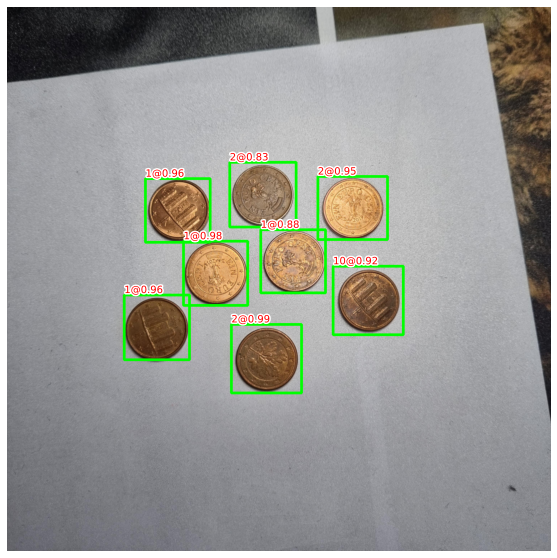

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


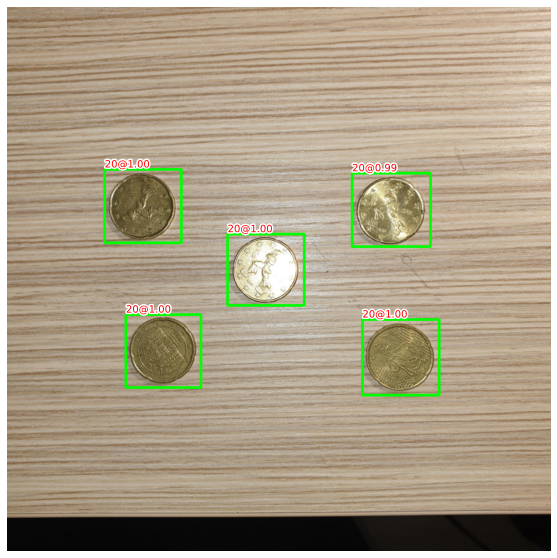

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


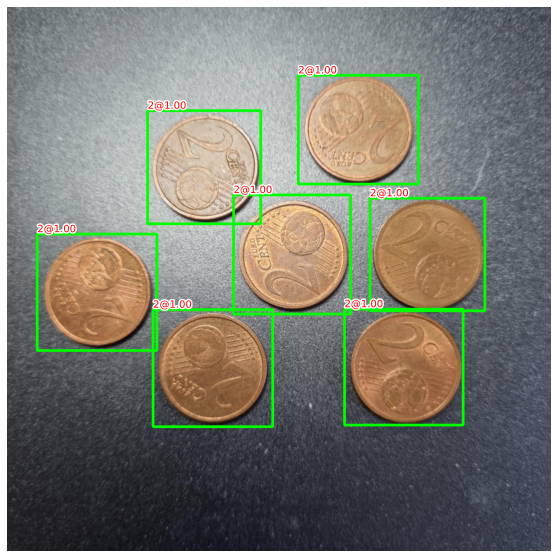

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


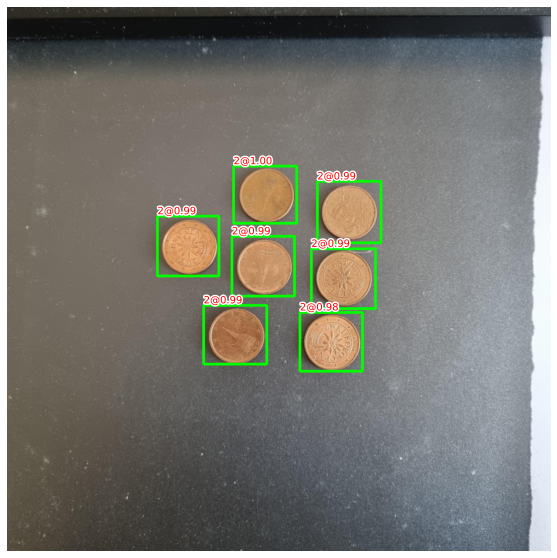

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


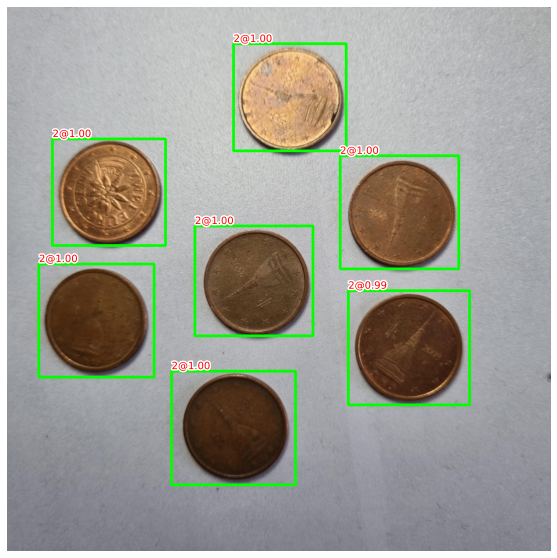

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


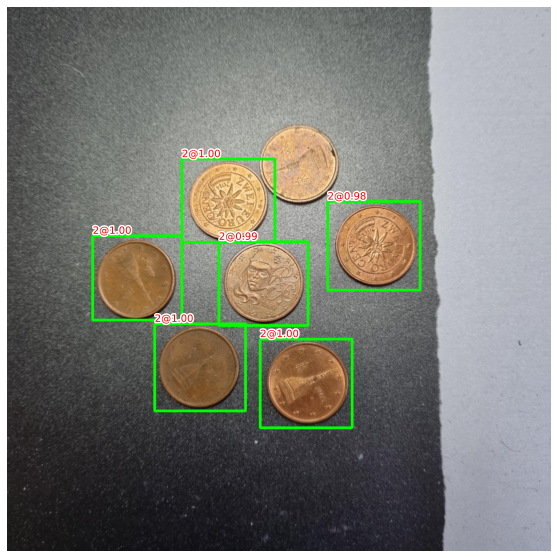

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


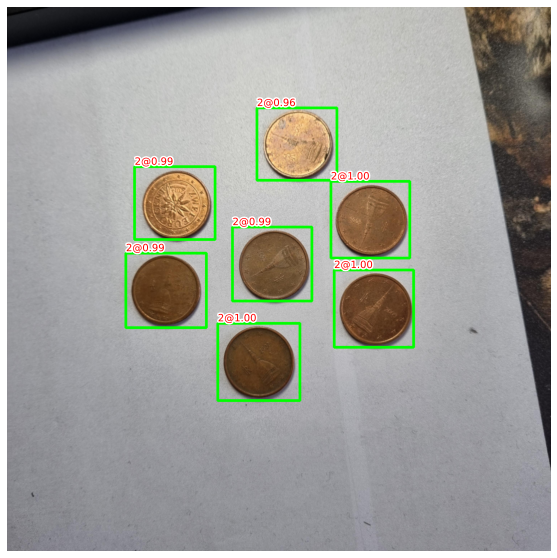

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


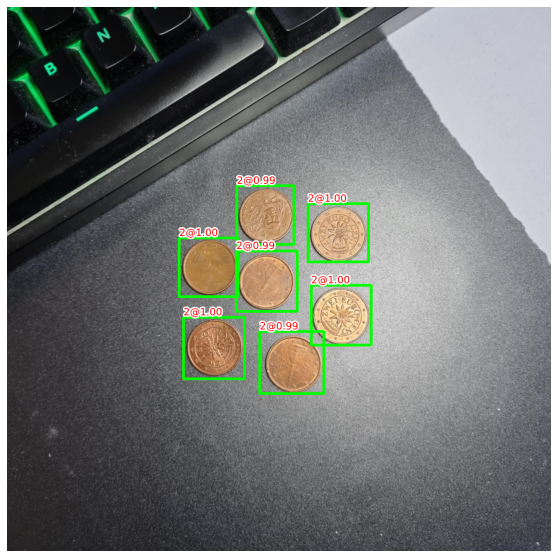

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


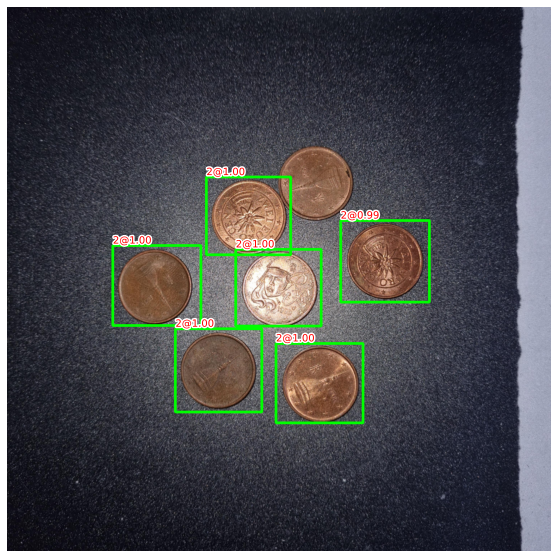

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


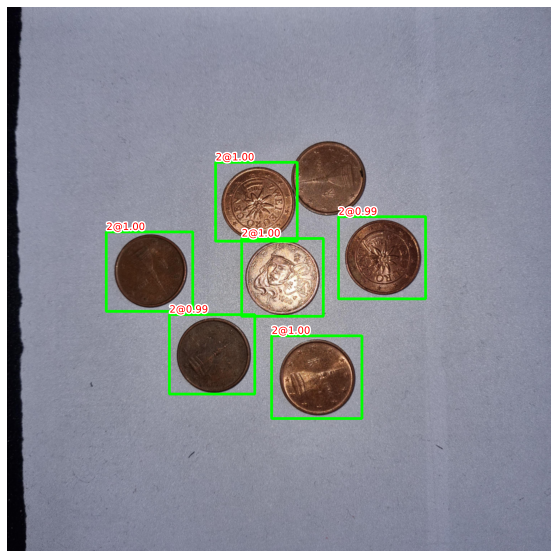

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


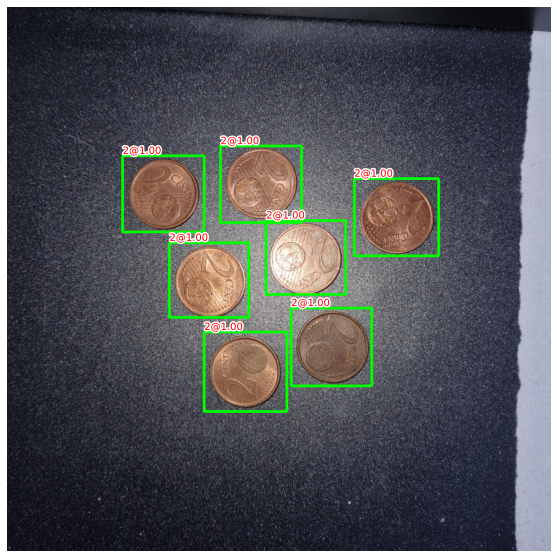

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


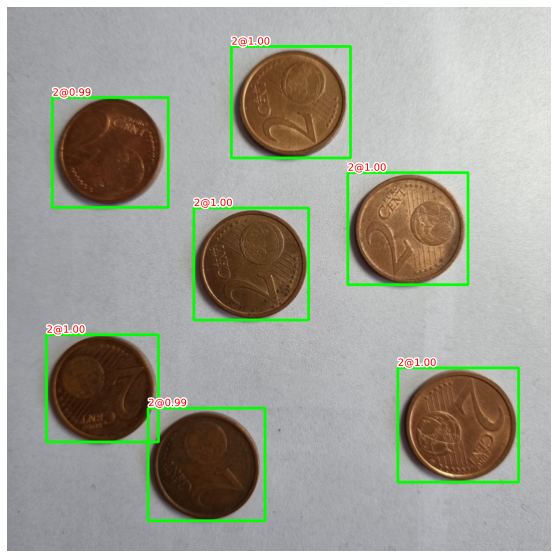

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


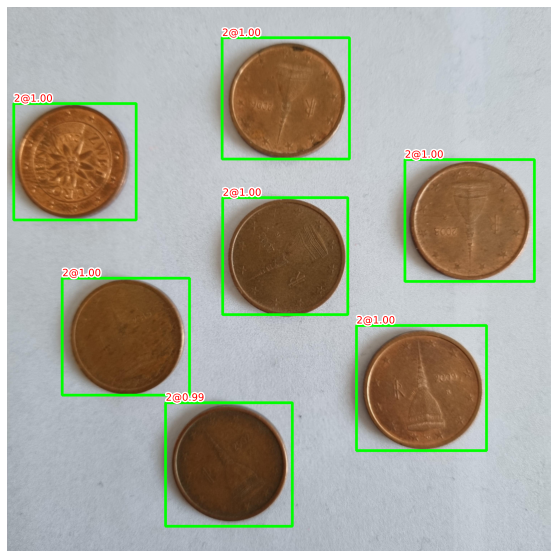

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


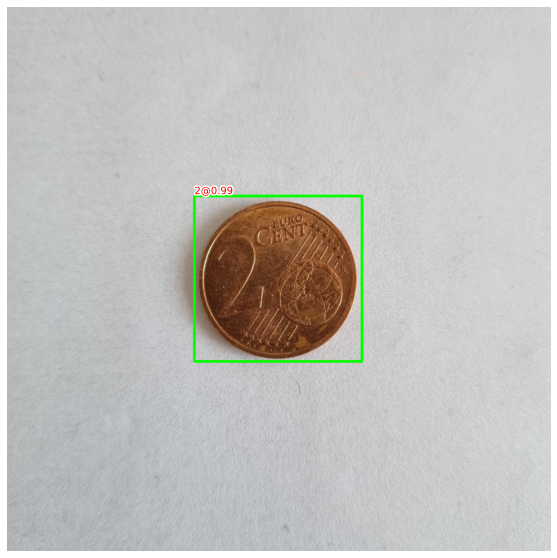

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


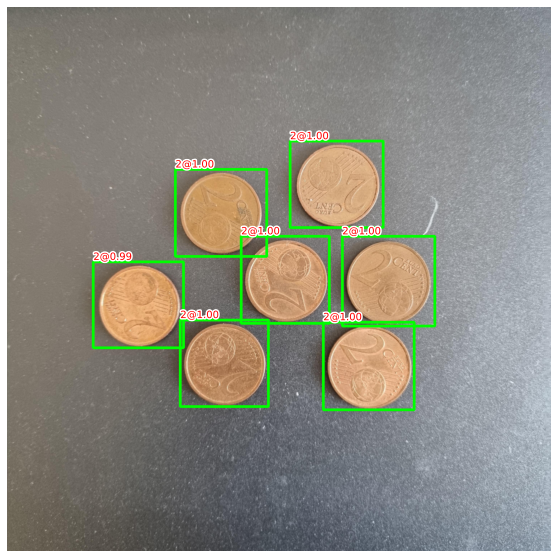

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


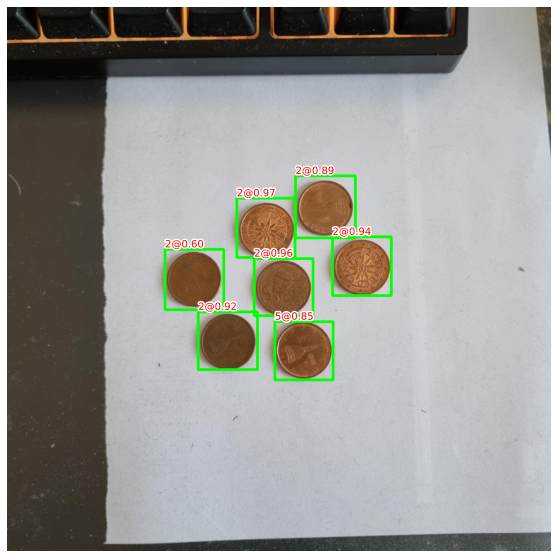

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


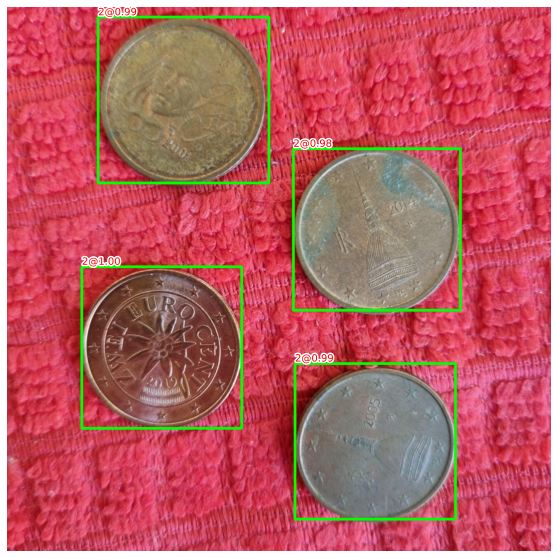

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


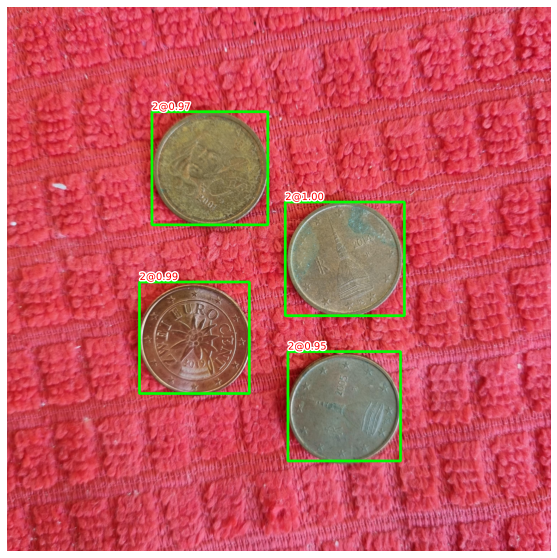

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


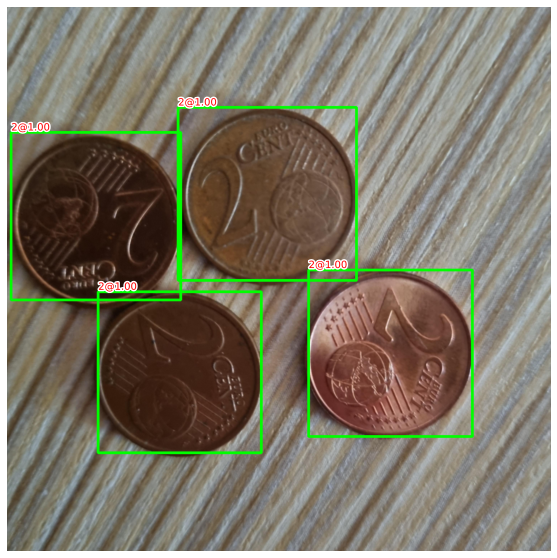

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


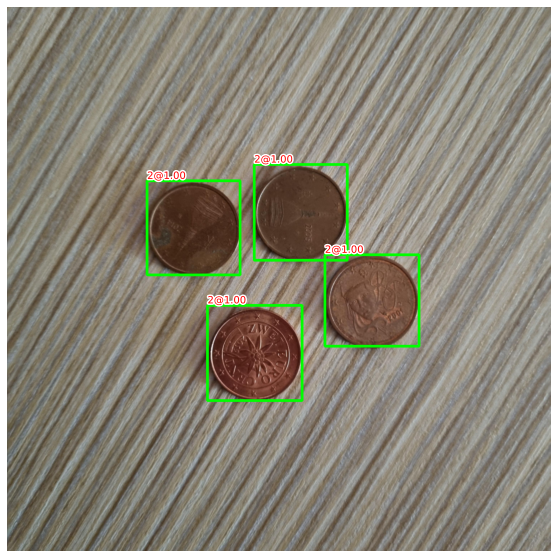

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


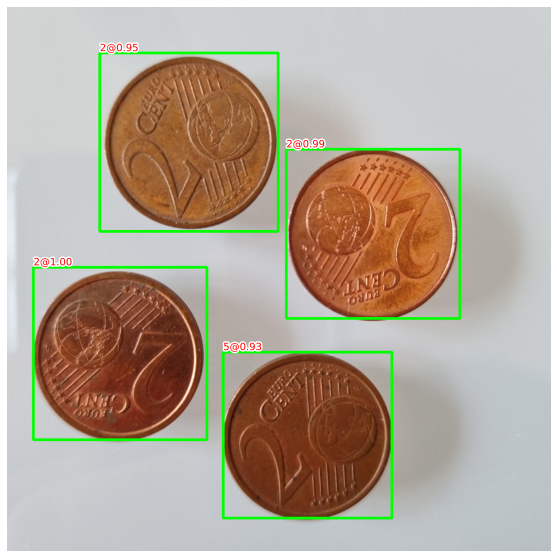

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


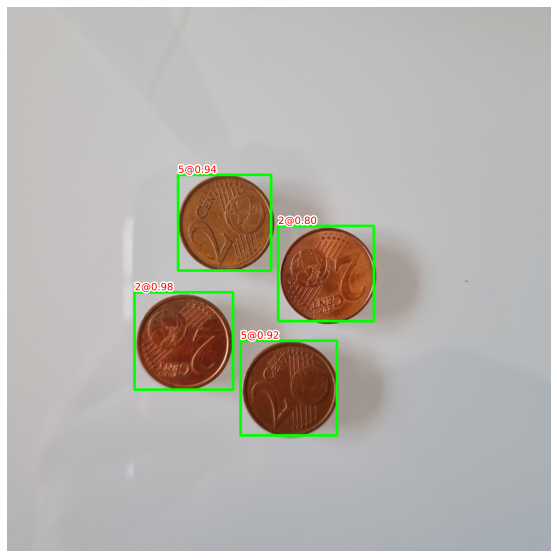

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


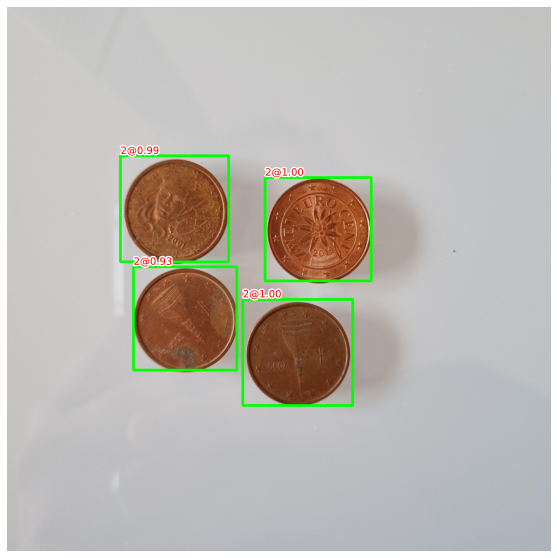

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


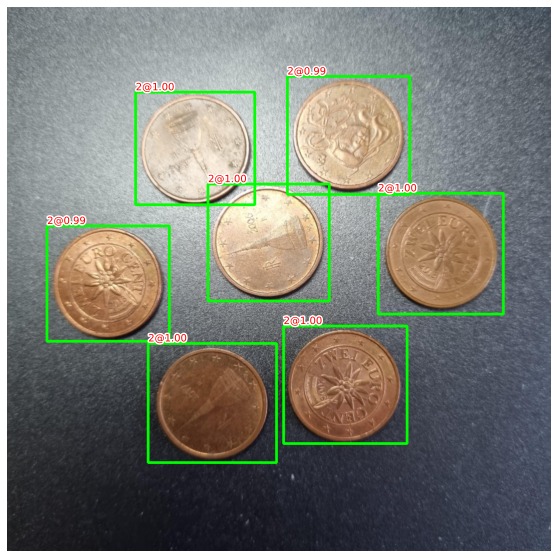

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


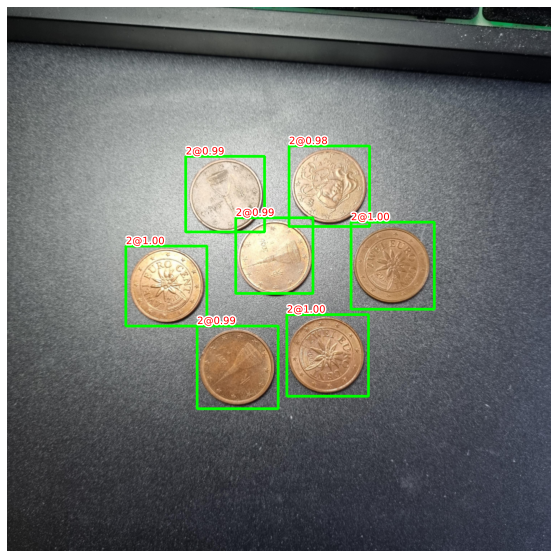

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


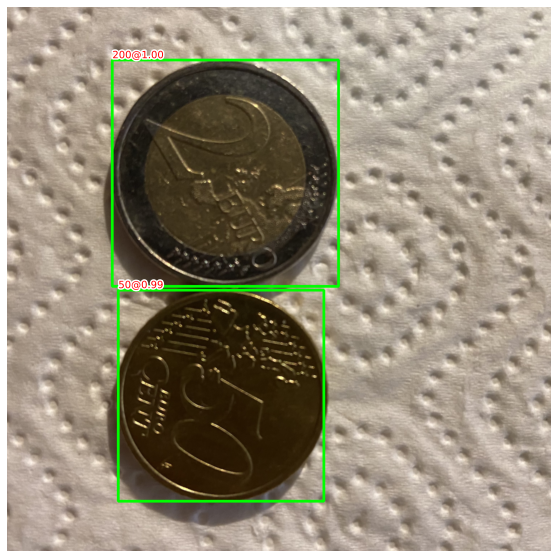

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


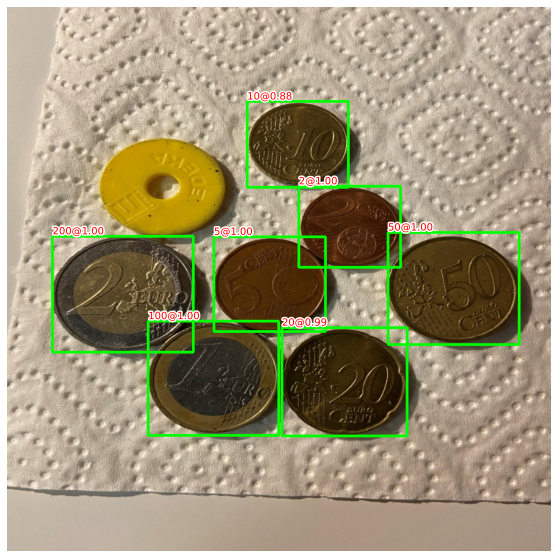

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


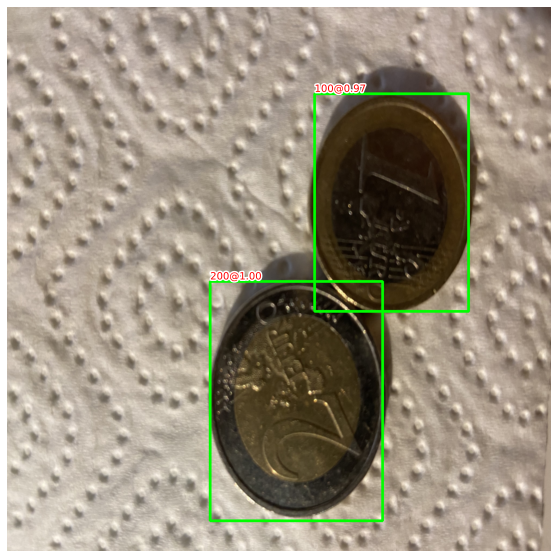

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


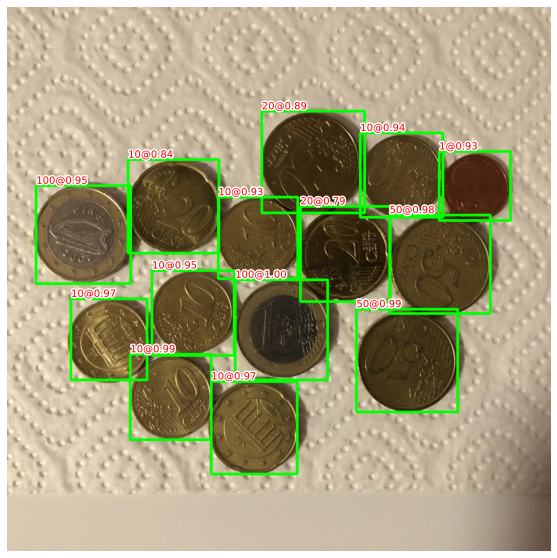

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


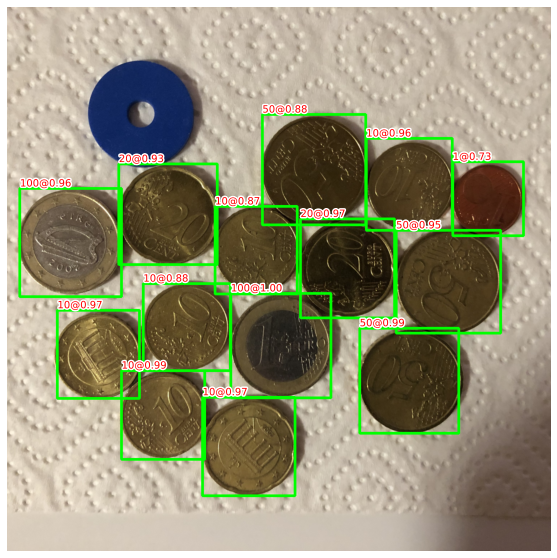

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


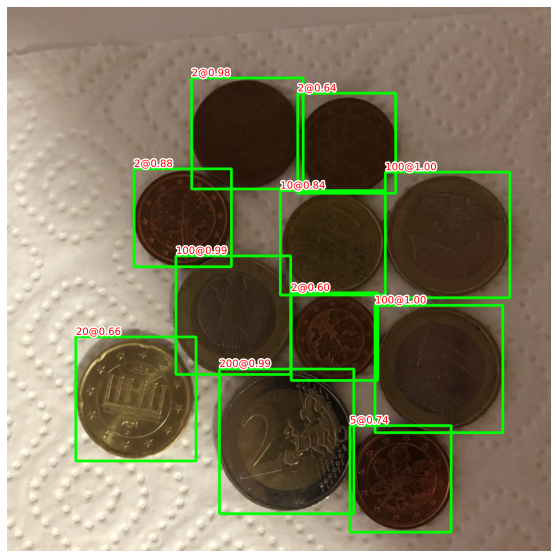

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


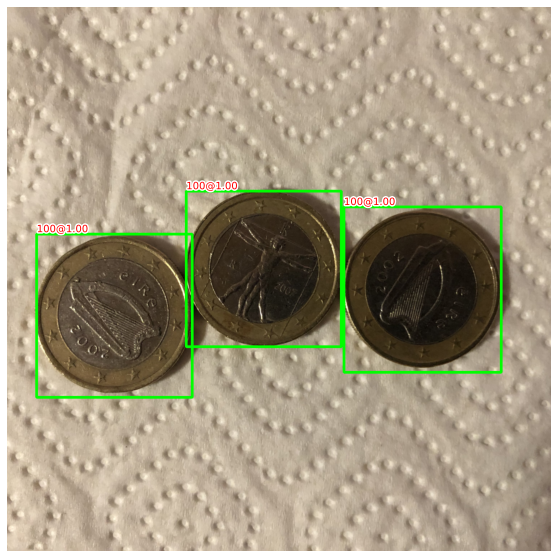

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


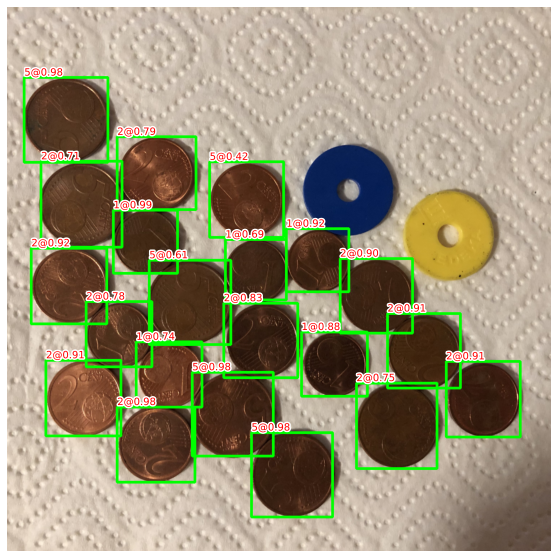

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


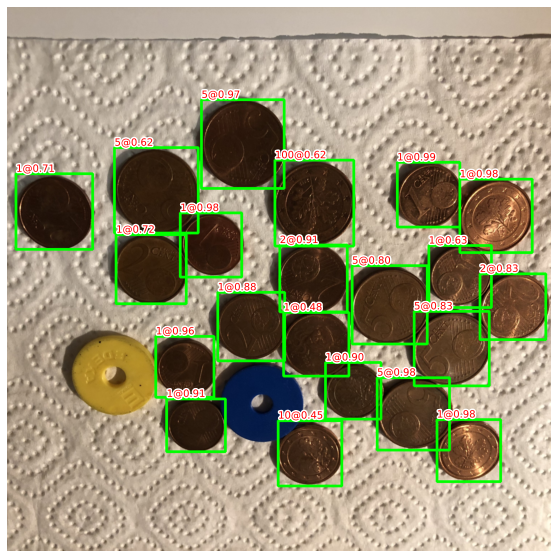

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


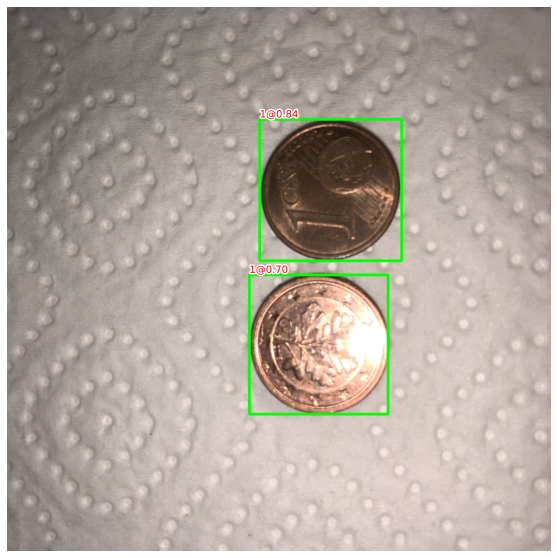

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


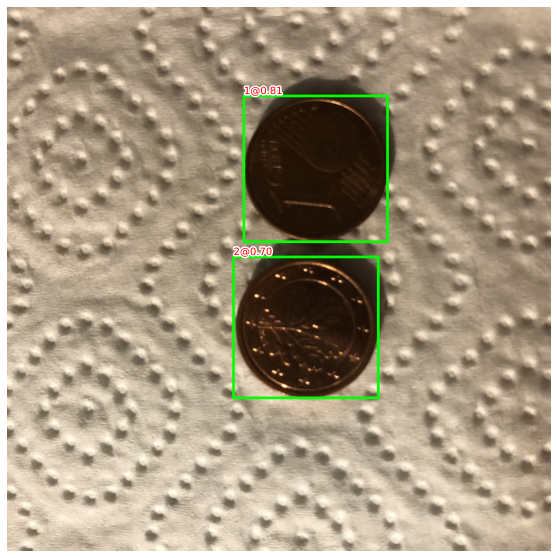

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


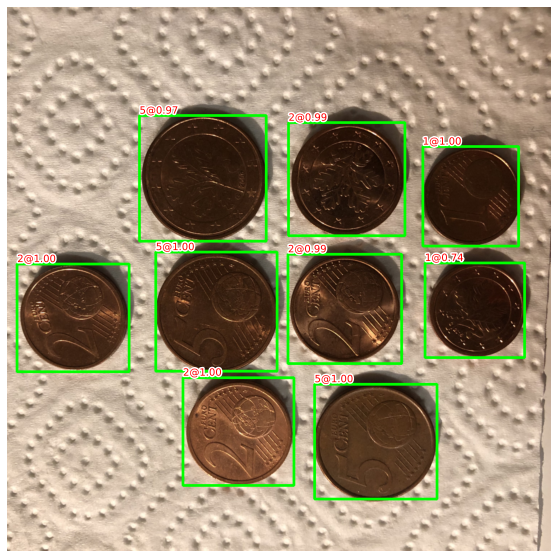

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


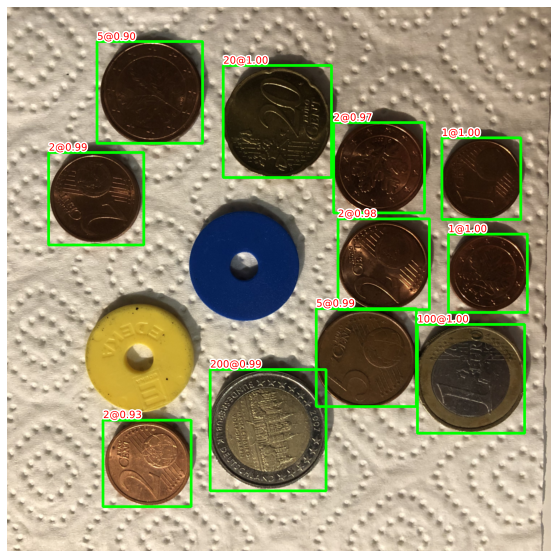

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


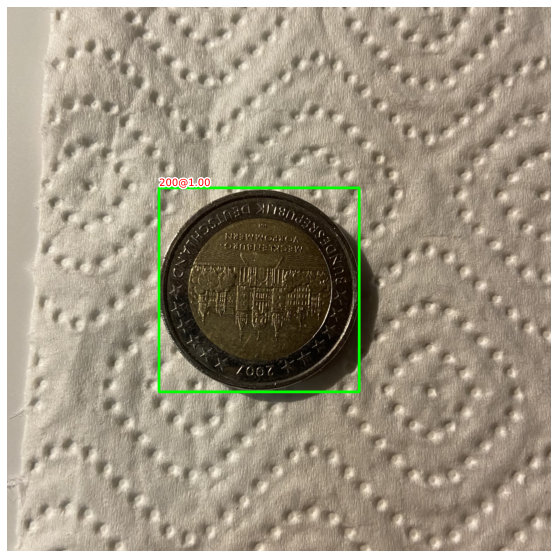

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


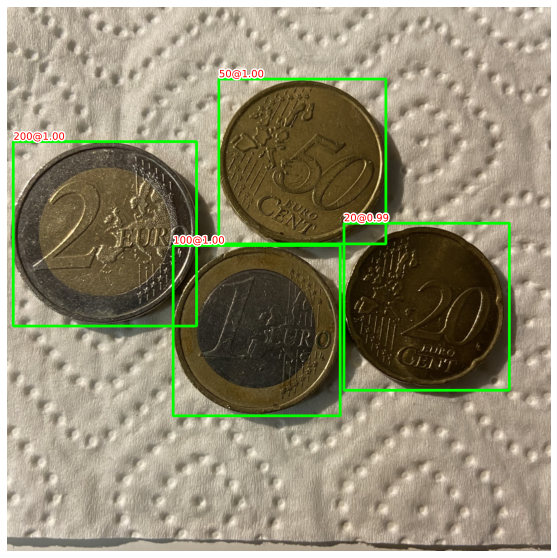

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


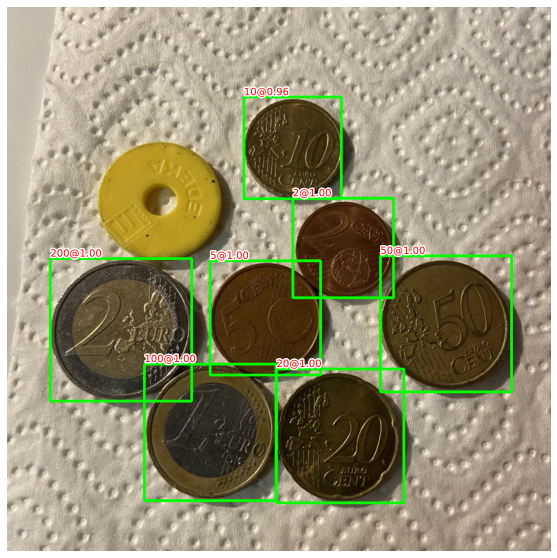

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


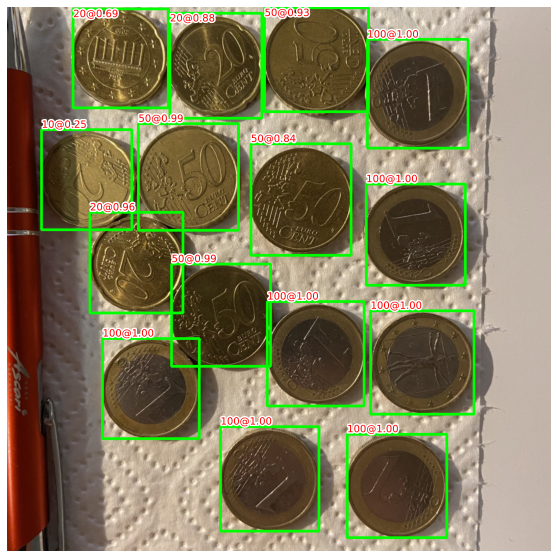

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


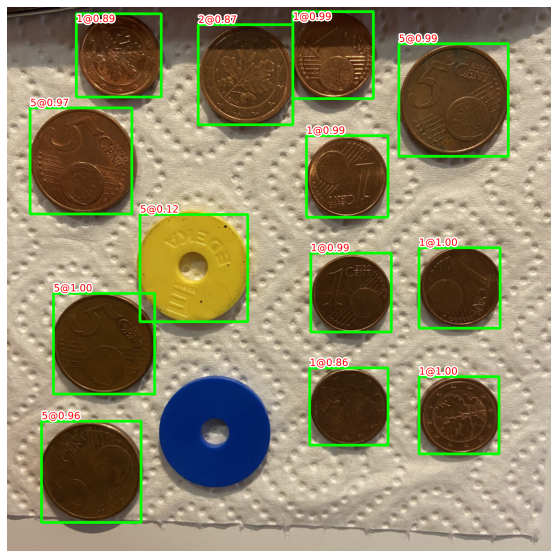

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


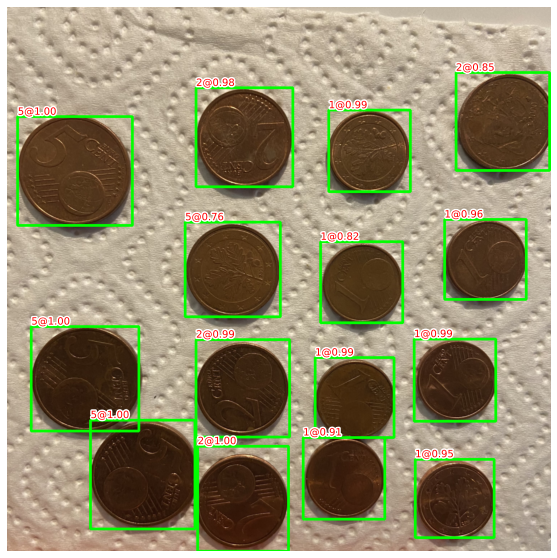

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


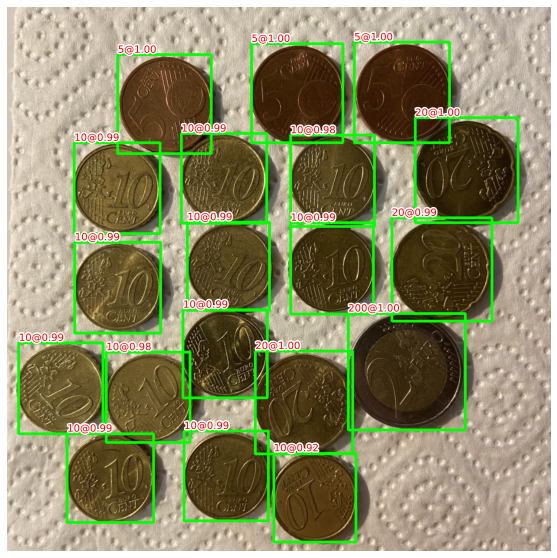

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


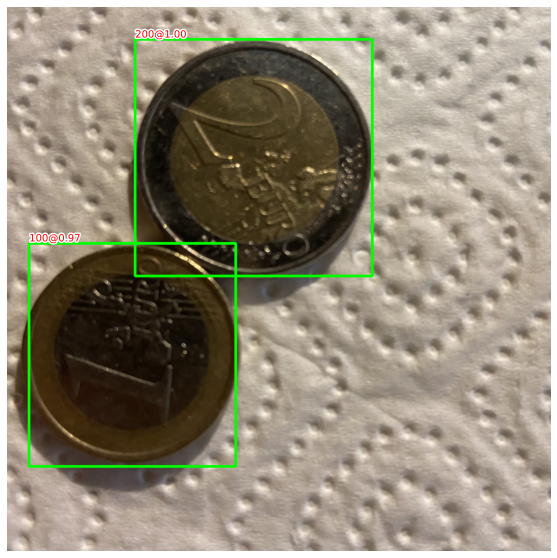

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


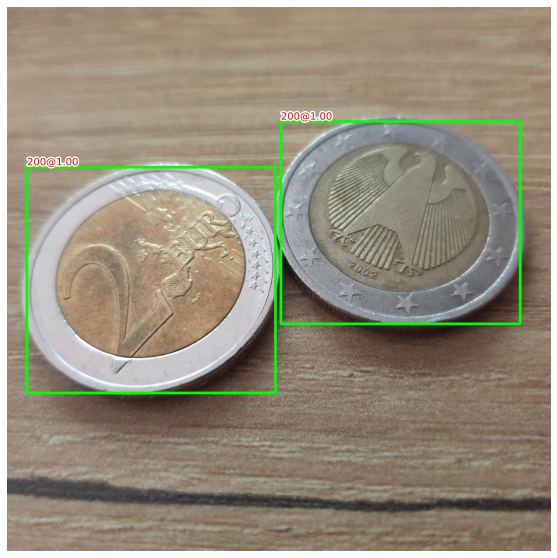

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


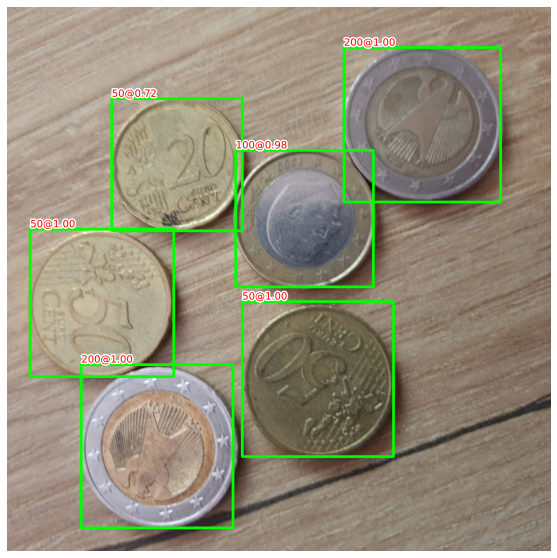

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


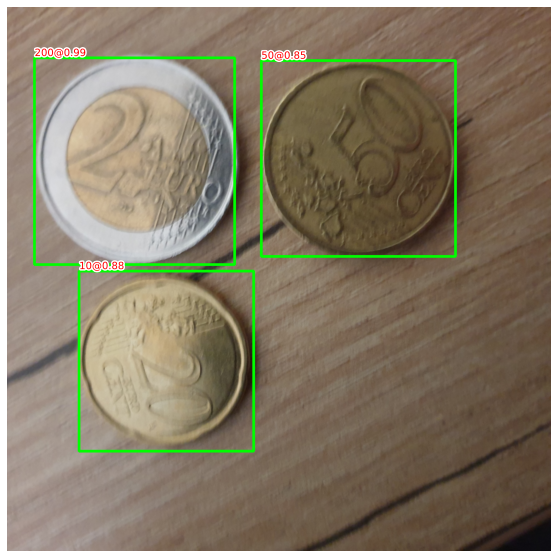

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


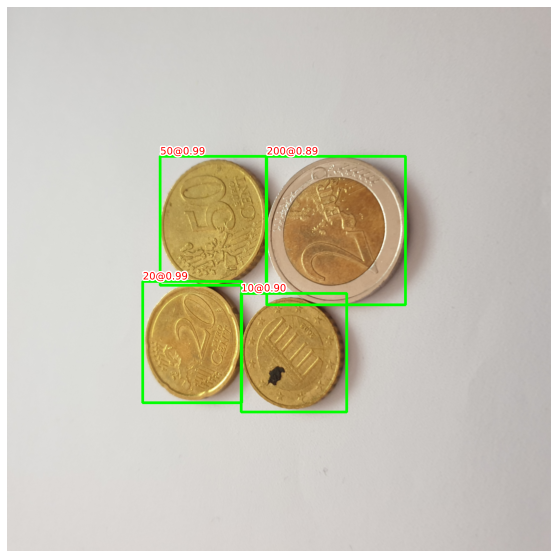

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


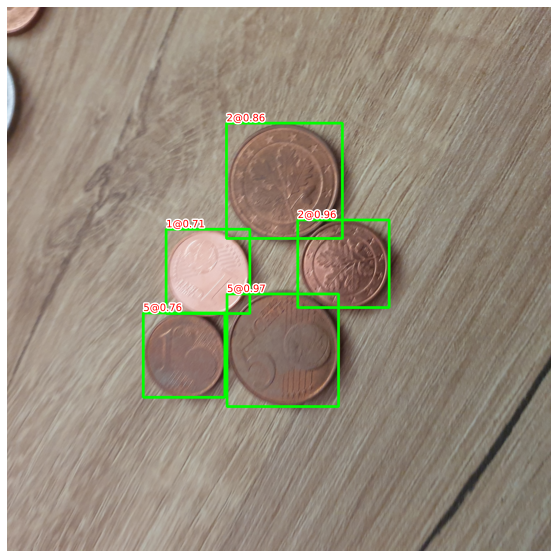

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


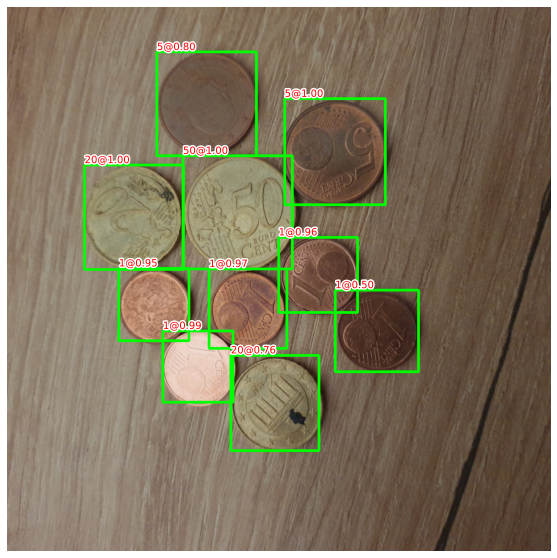

In [ ]:
model.eval()
for ix, (images, targets) in enumerate(test_loader):
  # print(ix)
  if ix<17:
    continue
  images = [im for im in images]
  outputs = model(images)
  # print(outputs)
  for ix, output in enumerate(outputs):
    bbs, confs, labels = decode_output(output)
    # print(bbs)
    # print(confs)
    # print(labels)
    info = [f'{l}@{c:.2f}' for l,c in zip(labels, confs)]
    show(images[ix].cpu().permute(1,2,0), bbs=bbs, texts=info, sz=10)

# Testing data augmentation


The data/image augementation is tested with the training data. It is checked whether, for example, the bounding boxes are rotated correctly during the horizontal flip. The bounding boxes correspond to the actual annotations and labels.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['contrast', 'saturation']


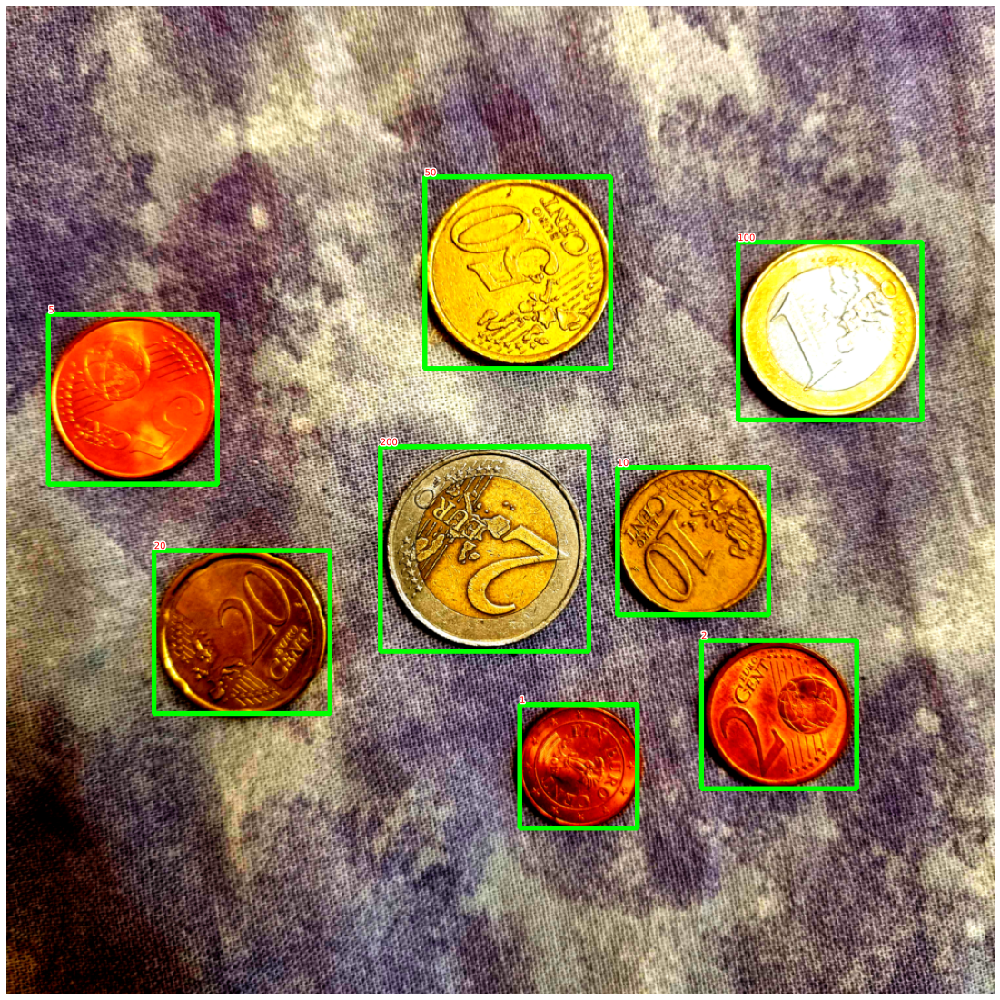

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['contrast', 'brightness', 'saturation', 'blur', 'hflip']


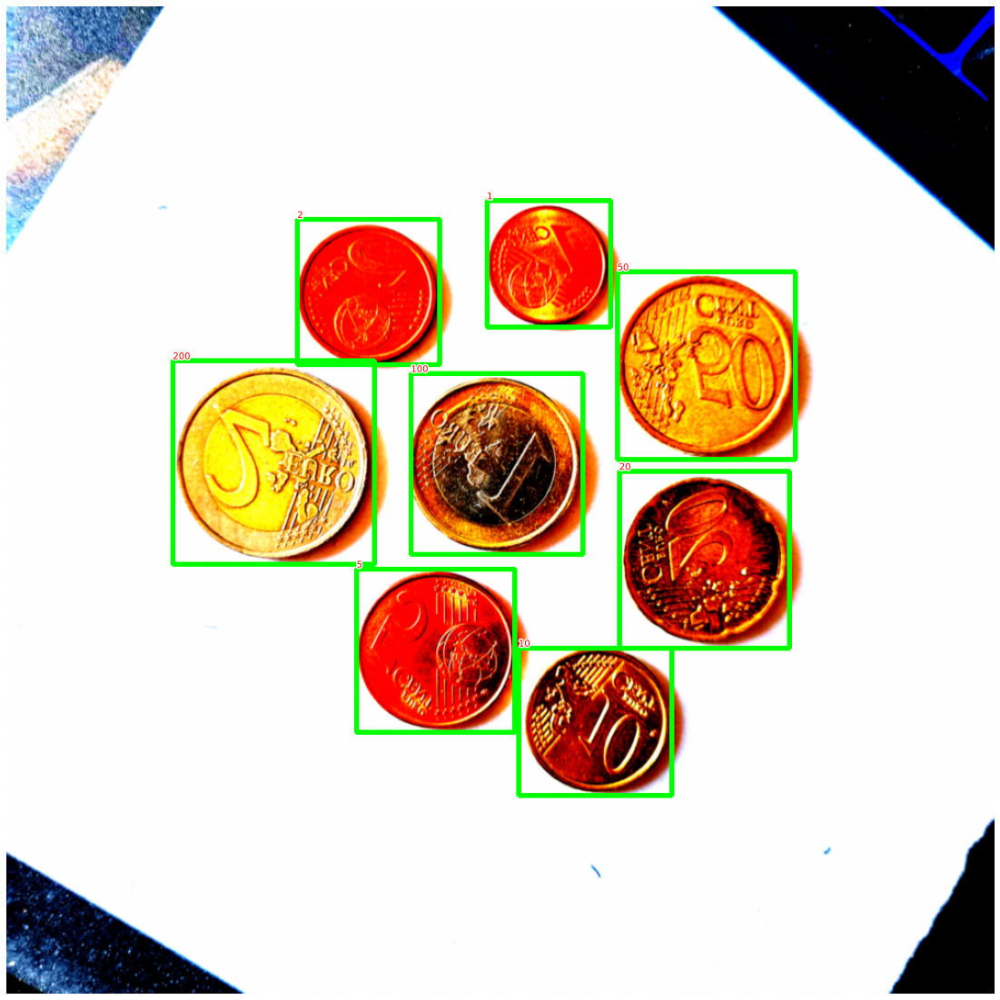

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['brightness', 'blur', 'grayscale', 'vflip']


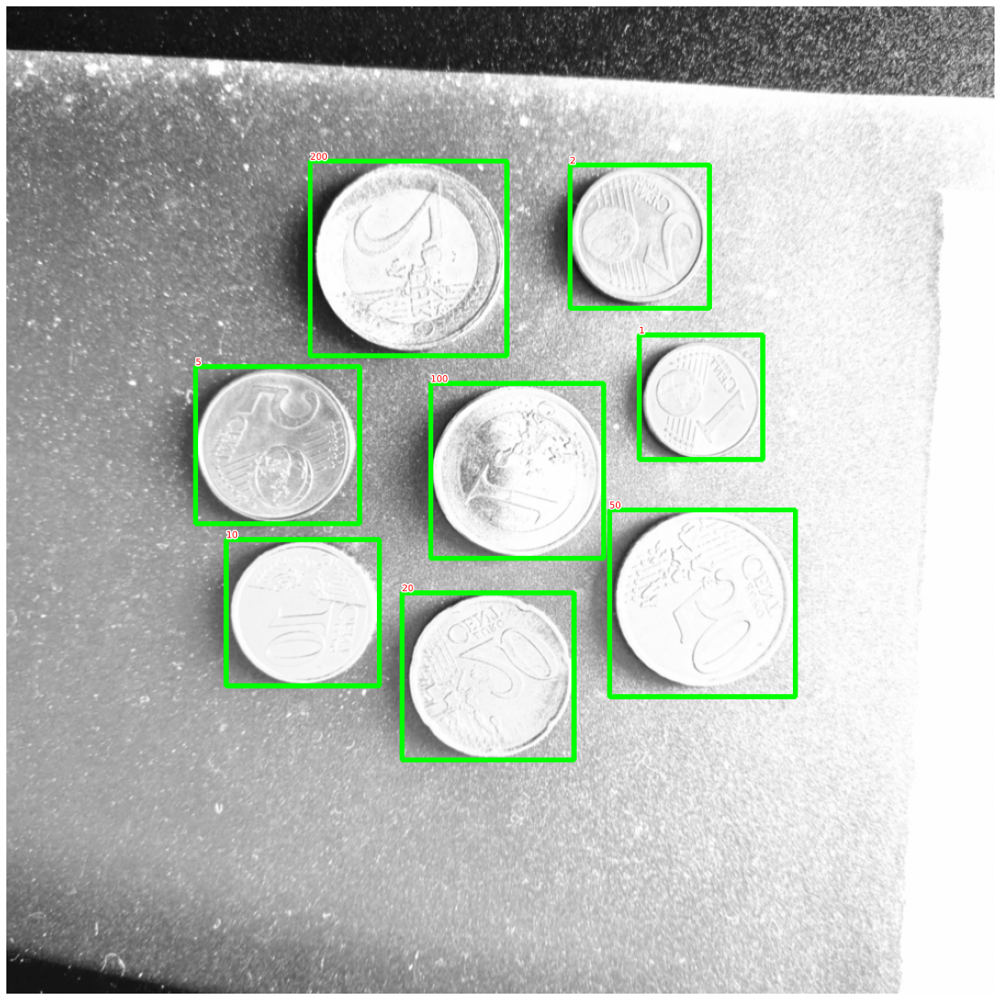

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['saturation', 'blur']


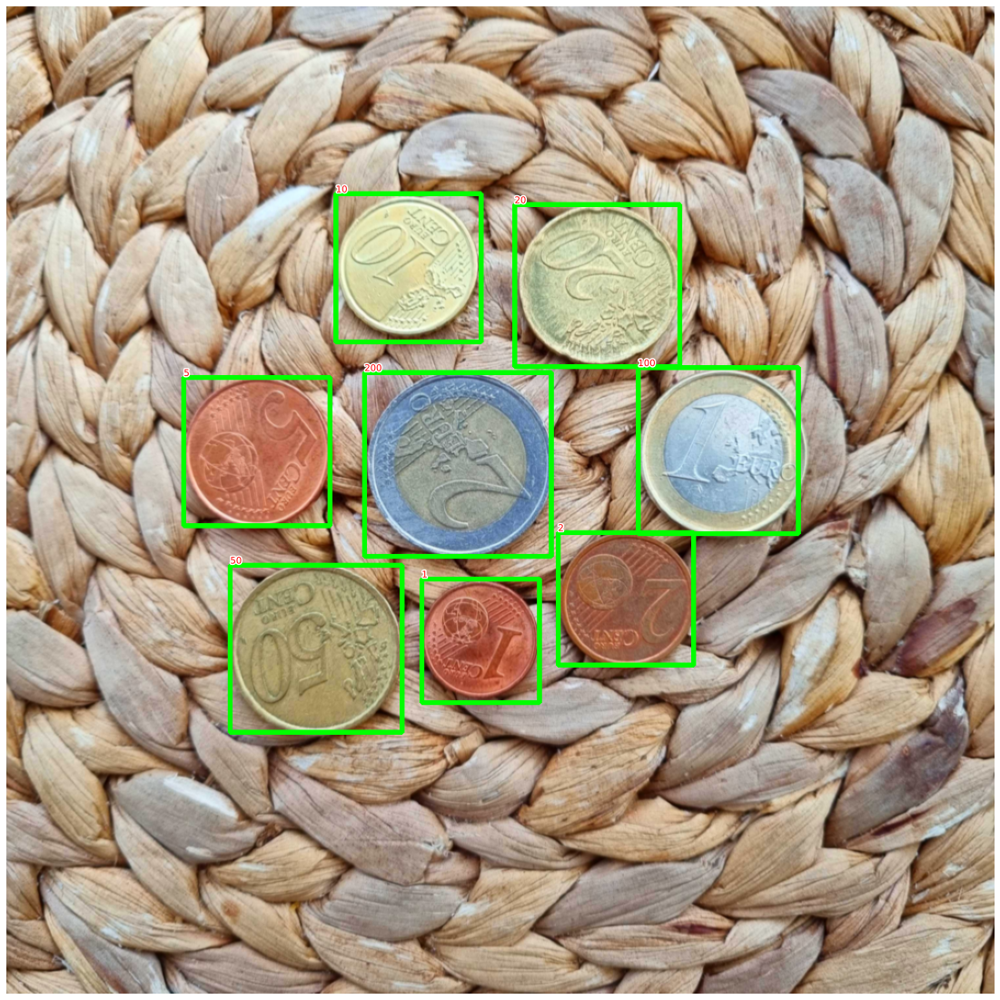

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['contrast', 'hflip', 'vflip']


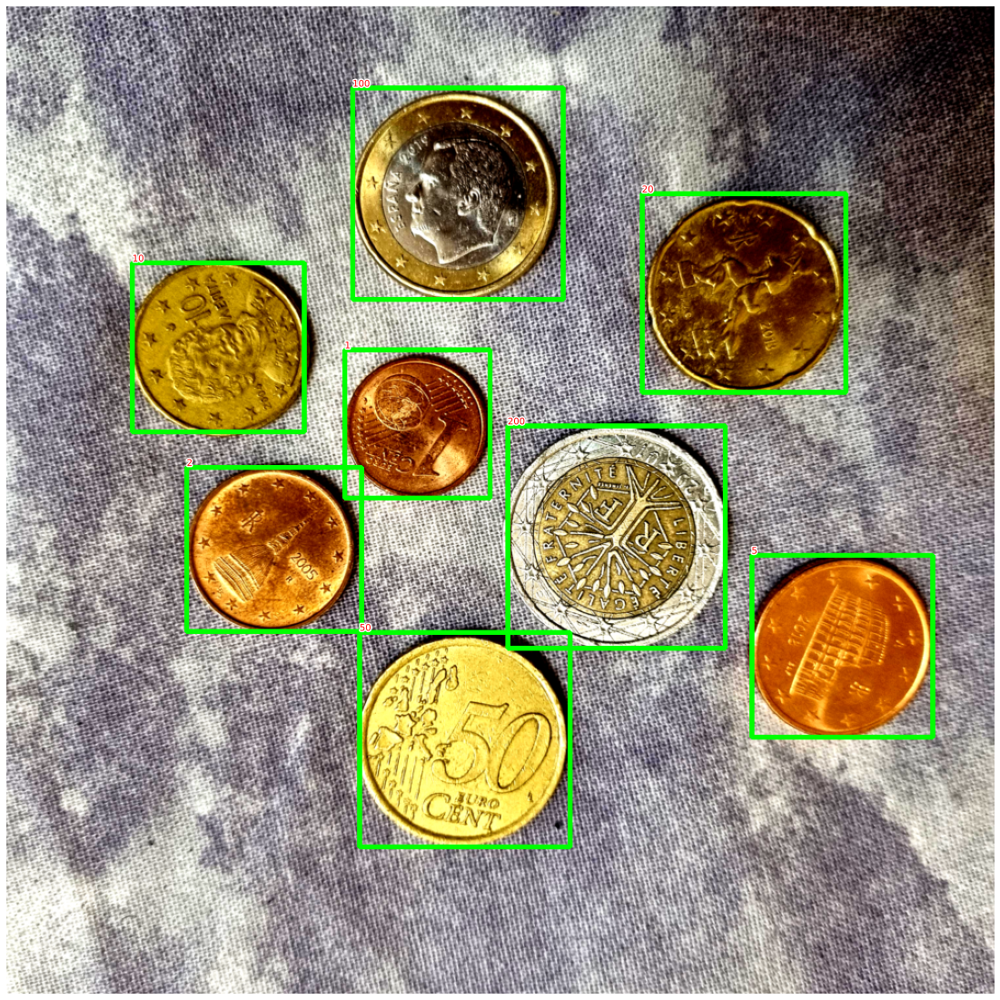

In [ ]:
for ix, fn in enumerate(df_train[df_train['folder'] == 'mixed']['filename'].unique()):
  if ix == 5:
    break
  try:
    data = df_train[df_train['filename'] == fn]
    labels = data['pose'].values.tolist()
    folder = data['folder'].values[0]
    # print(folder)
    data = data[['xmin','ymin','xmax','ymax']].values
    img = Image.open(os.path.join(IMAGE_ROOT, folder, fn))
    img, data, labels = random_transform(img, data, labels, threshold = 0.3)
    print(transform_log[-1]) # print performed transformations
    img, data = preprocess_traindata(img, data, width, height)
    show(img, bbs=data, texts = labels)

  except Exception as e:
    print(e)